## FINAL RESULTS

__All Data (2000 onwards)__
Per Game  
Linear: 0.417  
Polynomial: 0.377  
Polynomial, Scale, Lasso Regularization: 0.43205215961534926  

__All Stats__  
Linear: 0.522  
Polynomial: -62.454  
Polynomial, Scale, Lasso Regularization: 0.5874493473767233  

__All Stats - Total Stats__  
Linear: 0.526  
Polynomial: -8.306  
Polynomial, Scale, Lasso Regularization: 0.586620831588182  

__Advanced Stats__  
Linear: 0.365  
Polynomial: 0.370  
Polynomial, Scale, Lasso Regularization: 0.3874004642789921  

__2010 Onwards__  
Per Game Stats  
Linear: 0.478  
Polynomial: 0.469  
Polynomial, Scalar, Lasso Regularization: 0.5010236148146772  

__All Stats__  
Linear: 0.572  
Polynomial: -6.294  
Polynomial, Scalar, Lasso Regularization: 0.6473038990626366  

__Advanced Stats__  
Linear: 0.434  
Polynomial: 0.392  
Polynomial, Scalar, Lasso Regularization: 0.4754277253545216  

__2015 Onwards__
Per Game Stats  
Linear: 0.503  
Polynomial: 0.396  
Polynomial, Scalar, Lasso Regularization: 0.5224184691127534

__All Stats__  
Linear: 0.550  
Polynomial: 4.972  
Polynomial, Scalar, Lasso Regularization: 0.6028533325689674  

__Advanced Stats__  
Linear: 0.457  
Polynomial: 0.266  
Polynomial, Scalar, Lasso Regularization: 0.4736530940399357  

__2014 Onwards__  
All Stats  
Linear: 0.511  
Polynomial: -4.265  
Polynomial, Scalar, Lasso Regularization: 0.5524902098537983  

__2013 Onwards__  
All Stats  
Linear: 0.574  
Polynomial: -5.603  
Polynomial, Scalar, Lasso Regularization: 0.6265072330942109  

__2012 Onwards__  
All Stats  
Linear: 0.566  
Polynomial: -5.682  
Polynomial, Scalar, Lasso Regularization: 0.6456214131387047  

__2011 Onwards__  
All Stats  
Linear: 0.600  
Polynomial: -7.461  
Polynomial, Scalar, Lasso Regularization: 0.6628301119774314  

__All Stats - Total Stats__  
Linear: 0.599  
Polynomial: -7.512  
Polynomial, Scalar, Lasso Regularization:   
0.6649386010697077  

__All Stats - Total Stats (blk_per_mp and tov_pct dropped)__  
Linear: 0.601  
Polynomial: -10.517  
Polynomial, Scalar, Lasso Regularization: 0.6643971226722432  

__All Stats - Total Stats (tov_pct dropped)__  
Linear: 0.599  
Polynomial: -8.503  
Polynomial, Scalar, Lasso Regularization: 0.665312560516278  
ACTUAL(TEST): 0.5704606535697792  

>__2011 GIVES BEST RESULTS__


__———————DUMMY VARIABLES START————————__

__2011 Onwards__  
__Per Game Stats__  
Linear: 0.539  
Polynomial: 0.467  
Polynomial, Scalar, Lasso Regularization: 0.5554709156042115  

__All Stats__  
Linear: 0.571  
Polynomial: -7.171  
Polynomial, Scalar, Lasso Regularization:  

__———————DUMMY VARIABLES END——————————__

In [146]:
import pickle
import pandas as pd
pd.set_option('display.max_columns', None)  # No limit on number of columns displayed
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()   #Set seaborn default style

# This statement allows the visuals to render within your Jupyter Notebook
%matplotlib inline 

from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.pipeline import Pipeline

In [147]:
#Mean Absolute Error (MAE)
def mae(y_true, y_pred):
    return np.mean(np.abs(y_pred - y_true))

In [239]:
# Unpickle the df
with open('stats_df.pkl', 'rb') as picklefile: 
    df = pickle.load(picklefile)

In [240]:
# Set column order of df
df = df[['year',
         'salary',
         'salary cap',
         'name',
         'team_id',
         'pos',
         'age',          # 6 - start of numeric stats
         'g',  
         'gs',
         'mp_per_g',     # 9 - start of per game stats
         'fg_per_g',
         'fga_per_g',
         'fg_pct',
         'fg3_per_g',
         'fg3a_per_g',
         'fg3_pct',
         'fg2_per_g',
         'fg2a_per_g',
         'fg2_pct',
         'efg_pct',
         'ft_per_g',
         'fta_per_g',
         'ft_pct',
         'orb_per_g',
         'drb_per_g',
         'trb_per_g',
         'ast_per_g',
         'stl_per_g',
         'blk_per_g',
         'tov_per_g',
         'pf_per_g',
         'pts_per_g',    # 31 - end of per game stats
         'fg_per_mp',    # 32 - start of per 36 min stats
         'fga_per_mp',
         'fg3_per_mp',
         'fg3a_per_mp',
         'fg2_per_mp',
         'fg2a_per_mp',
         'ft_per_mp',
         'fta_per_mp',
         'orb_per_mp',
         'drb_per_mp',
         'trb_per_mp',
         'ast_per_mp',
         'stl_per_mp',
         'blk_per_mp',
         'tov_per_mp',
         'pf_per_mp',
         'pts_per_mp',   # 48 - end of per 36 min stats
         'fg_per_poss',  # 49 - start of per 100 possession stats
         'fga_per_poss',
         'fg3_per_poss',
         'fg3a_per_poss',
         'fg2_per_poss',
         'fg2a_per_poss',
         'ft_per_poss',
         'fta_per_poss',
         'orb_per_poss',
         'drb_per_poss',
         'trb_per_poss',
         'ast_per_poss',
         'stl_per_poss',
         'blk_per_poss',
         'tov_per_poss',
         'pf_per_poss',
         'pts_per_poss',
         'off_rtg',      
         'def_rtg',      # 67 - end of per 100 possesion stats
         'fg',           # 68 - start of total stats
         'fga',
         'fg3',
         'fg3a',
         'fg2',
         'fg2a',
         'ft',
         'fta',
         'orb',
         'drb',
         'trb',
         'ast',
         'stl',
         'blk',
         'tov',
         'pf',
         'pts',         # 84 - end of total stats
         'per',         # 85 - start of advanced stats
         'ts_pct',
         'fg3a_per_fga_pct',
         'fta_per_fga_pct',
         'orb_pct',
         'drb_pct',
         'trb_pct',
         'ast_pct',
         'stl_pct',
         'blk_pct',
         'tov_pct',
         'usg_pct',
         'ows',
         'dws',
         'ws',
         'ws_per_48',
         'obpm',
         'dbpm',
         'bpm',
         'vorp',        # 104 - end of advanced stats
         'salary ratio']]  # 105 - target

In [241]:
# Test data
# 2019 stats (i.e. 2018-2019 season)
# Want to use our model to predict R^2 on this
test_2019_df = df[df.year == 2019]

In [238]:
test_2019_df.head()

,year,salary,salary cap,name,team_id,pos,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,def_rtg,fg,fga,fg3,fg3a,fg2,fg2a,ft,fta,orb,drb,trb,ast,stl,blk,tov,pf,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,tov_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,salary ratio
0,2019,5455236.0,101869000,ALEX ABRINES,OKC,SG,25,31,2,19.0,1.8,5.1,0.357,1.3,4.1,0.323,0.5,1.0,0.500,0.487,0.4,0.4,0.923,0.2,1.4,1.5,0.6,0.5,0.2,0.5,1.7,5.3,3.4,9.6,2.5,7.8,0.9,1.8,0.7,0.8,0.3,2.6,2.9,1.2,1.0,0.4,0.9,3.2,10.1,4.4,12.5,3.3,10.1,1.2,2.4,1.0,1.0,0.4,3.4,3.8,1.6,1.3,0.5,1.1,4.2,13.1,103.0,111.0,56,157,41,127,15,30,12,13,5,43,48,20,17,6,14,53,165,6.3,0.507,0.809,0.083,0.9,7.8,4.2,4.3,1.3,0.9,7.9,12.2,0.1,0.6,0.6,0.053,-2.4,-0.9,-3.4,-0.2,0.053551
2,2019,270014.0,101869000,JAYLEN ADAMS,ATL,PG,22,34,1,12.6,1.1,3.2,0.345,0.7,2.2,0.338,0.4,1.1,0.361,0.459,0.2,0.3,0.778,0.3,1.4,1.8,1.9,0.4,0.1,0.8,1.3,3.2,3.2,9.3,2.1,6.2,1.1,3.0,0.6,0.8,0.9,4.1,5.0,5.5,1.2,0.4,2.4,3.8,9.1,4.1,11.9,2.7,8.0,1.4,3.9,0.8,1.0,1.2,5.3,6.5,7.0,1.5,0.5,3.0,4.9,11.7,99.0,115.0,38,110,25,74,13,36,7,9,11,49,60,65,14,5,28,45,108,7.6,0.474,0.673,0.082,2.6,12.3,7.4,19.8,1.5,1.0,19.7,13.5,-0.1,0.2,0.1,0.011,-3.1,-1.3,-4.4,-0.3,0.002651
3,2019,24157303.0,101869000,STEVEN ADAMS,OKC,C,25,80,80,33.4,6.0,10.1,0.595,0.0,0.0,0.000,6.0,10.1,0.596,0.595,1.8,3.7,0.500,4.9,4.6,9.5,1.6,1.5,1.0,1.7,2.6,13.9,6.5,10.9,0.0,0.0,6.5,10.9,2.0,3.9,5.3,5.0,10.3,1.7,1.6,1.0,1.8,2.8,14.9,8.4,14.1,0.0,0.0,8.4,14.1,2.6,5.1,6.8,6.5,13.3,2.2,2.0,1.3,2.4,3.6,19.4,120.0,106.0,481,809,0,2,481,807,146,292,391,369,760,124,117,76,135,204,1108,18.5,0.591,0.002,0.361,14.7,14.8,14.7,6.6,2.0,2.4,12.6,16.4,5.1,4.0,9.1,0.163,0.6,2.1,2.7,3.2,0.237141
4,2019,2955840.0,101869000,BAM ADEBAYO,MIA,C,21,82,28,23.3,3.4,5.9,0.576,0.0,0.2,0.200,3.4,5.7,0.588,0.579,2.0,2.8,0.735,2.0,5.3,7.3,2.2,0.9,0.8,1.5,2.5,8.9,5.3,9.1,0.1,0.3,5.2,8.9,3.1,4.3,3.1,8.1,11.2,3.5,1.3,1.2,2.3,3.8,13.7,7.2,12.4,0.1,0.4,7.1,12.0,4.2,5.8,4.2,11.0,15.2,4.7,1.8,1.7,3.1,5.2,18.6,120.0,104.0,280,486,3,15,277,471,166,226,165,432,597,184,71,65,121,203,729,17.9,0.623,0.031,0.465,9.2,24.0,16.6,14.2,1.8,3.0,17.1,15.8,3.4,3.4,6.8,0.171,-0.6,3.6,3.0,2.4,0.029016
7,2019,22347015.0,101869000,LAMARCUS ALDRIDGE,SAS,C,33,81,81,33.2,8.4,16.3,0.519,0.1,0.5,0.238,8.3,15.8,0.528,0.522,4.3,5.1,0.847,3.1,6.1,9.2,2.4,0.5,1.3,1.8,2.2,21.3,9.2,17.7,0.1,0.6,9.0,17.1,4.7,5.5,3.4,6.6,10.0,2.6,0.6,1.4,1.9,2.4,23.1,12.4,24.0,0.2,0.8,12.3,23.2,6.3,7.5,4.6,9.0,13.5,3.5,0.8,1.9,2.6,3.3,31.4,117.0,110.0,684,1319,10,42,674,1277,349,412,251,493,744,194,43,107,144,179,1727,22.9,0.576,0.032,0.312,10.3,19.8,15.1,11.6,0.8,3.4,8.8,26.9,6.4,2.9,9.3,0.167,1.2,0.5,1.6,2.5,0.219370


In [242]:
# Train and validation data
# 2010 - 2018 stats
train_val_df = df[(df.year > 2010) & (df.year != 2019)]

In [243]:
train_val_df.drop(columns=['tov_pct'], inplace=True)  # Need to drop the corr year column
test_2019_df.drop(columns=['tov_pct'], inplace=True)  # Need to drop the corr year column

//anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4097: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


### Data Analysis

In [10]:
train_val_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6007 entries, 1 to 539
Columns: 106 entries, year to salary ratio
dtypes: float64(81), int64(22), object(3)
memory usage: 4.9+ MB


In [11]:
train_val_df.describe()

,year,salary,salary cap,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,def_rtg,fg,fga,fg3,fg3a,fg2,fg2a,ft,fta,orb,drb,trb,ast,stl,blk,tov,pf,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,tov_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,salary ratio
count,6007.000000,6.007000e+03,6.007000e+03,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000,6007.000000
mean,2010.232396,4.681827e+06,5.978051e+07,26.591310,59.161645,30.090561,22.502164,3.440952,7.721292,0.436992,0.677210,1.923240,0.281327,2.763909,5.797336,0.466490,0.480748,1.675845,2.195905,0.745377,0.961162,2.802847,3.761828,2.060762,0.716914,0.415282,1.294173,1.925204,9.233078,5.183369,11.862194,1.045880,3.059164,4.136174,8.803196,2.450774,3.271250,1.571117,4.418012,5.989362,3.089862,1.132862,0.663726,2.030481,3.299101,13.865823,7.439754,17.032346,1.497553,4.374763,5.942417,12.656551,3.520676,4.700150,2.258798,6.339088,8.597220,4.435442,1.627851,0.952838,2.917197,4.742900,19.898452,103.990844,106.771600,225.524721,500.720493,43.805727,122.702514,181.718995,378.017979,110.220909,143.874979,62.360579,182.270185,244.630764,133.652905,46.067088,27.196937,83.079241,121.942567,605.076078,13.436724,0.519047,0.257121,0.279555,4.985966,14.018412,9.500033,13.883353,1.627818,1.426769,13.404212,19.229832,1.621708,1.448310,3.070385,0.081731,-0.876128,-0.348693,-1.224188,0.764625,0.080653
std,5.241036,4.980762e+06,1.667323e+07,4.198767,21.416769,29.928121,9.353390,2.121751,4.487092,0.065594,0.677738,1.757677,0.155490,1.920647,3.834047,0.069876,0.064713,1.437318,1.787240,0.120945,0.814227,1.762160,2.448509,1.795655,0.426031,0.465742,0.781862,0.748548,5.829016,1.553491,3.108471,0.904778,2.364198,1.688307,3.241064,1.371768,1.723771,1.163477,1.777416,2.711201,1.978113,0.476555,0.657755,0.785403,1.159120,4.207112,2.209848,4.435024,1.286850,3.360515,2.425040,4.688785,1.969598,2.473325,1.673758,2.531658,3.879084,2.836639,0.683706,0.946145,1.122968,1.675587,5.973698,10.473938,4.164424,172.428163,369.043247,49.825066,130.252476,152.005755,305.690183,109.750675,137.742581,61.750018,142.895174,197.015153,134.601057,34.209385,34.397284,62.695879,69.814281,471.576624,4.664422,0.061533,0.196002,0.140975,3.679344,5.590263,4.280121,9.028016,0.683676,1.

In [164]:
train_val_df.year.unique()

array([2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
       2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018])

In [196]:
years = train_val_df.year.unique()  # List of years
corr_years_df = pd.DataFrame()  # Empty df to be filled with corr for every year
for year in years:
    corr_years_df = corr_years_df.append(train_val_df[train_val_df['year'] == year]
                                         .corr()
                                         .iloc[-1, :]
                                        )  # Only want last row of corr()

corr_years_df.drop(columns='year', inplace=True)  # Need to drop the corr year column
corr_years_df.insert(loc=0, column='year', value=np.arange(2000, 2019))

In [197]:
corr_years_df

,year,age,ast,ast_pct,ast_per_g,ast_per_mp,ast_per_poss,blk,blk_pct,blk_per_g,blk_per_mp,blk_per_poss,bpm,dbpm,def_rtg,drb,drb_pct,drb_per_g,drb_per_mp,drb_per_poss,dws,efg_pct,fg,fg2,fg2_pct,fg2_per_g,fg2_per_mp,fg2_per_poss,fg2a,fg2a_per_g,fg2a_per_mp,fg2a_per_poss,fg3,fg3_pct,fg3_per_g,fg3_per_mp,fg3_per_poss,fg3a,fg3a_per_fga_pct,fg3a_per_g,fg3a_per_mp,fg3a_per_poss,fg_pct,fg_per_g,fg_per_mp,fg_per_poss,fga,fga_per_g,fga_per_mp,fga_per_poss,ft,ft_pct,ft_per_g,ft_per_mp,ft_per_poss,fta,fta_per_fga_pct,fta_per_g,fta_per_mp,fta_per_poss,g,gs,mp_per_g,obpm,off_rtg,orb,orb_pct,orb_per_g,orb_per_mp,orb_per_poss,ows,per,pf,pf_per_g,pf_per_mp,pf_per_poss,pts,pts_per_g,pts_per_mp,pts_per_poss,salary,salary cap,salary ratio,stl,stl_pct,stl_per_g,stl_per_mp,stl_per_poss,tov,tov_pct,tov_per_g,tov_per_mp,tov_per_poss,trb,trb_pct,trb_per_g,trb_per_mp,trb_per_poss,ts_pct,usg_pct,vorp,ws,ws_per_48
salary ratio,2000,0.220850,0.300246,0.160633,0.298761,0.121603,0.128468,0.332490,0.133729,0.329152,0.135556,0.133243,0.337007,0.257067,-0.173885,0.561343,0.257652,0.568517,0.240798,0.251098,0.515011,0.127974,0.537152,0.578608,0.199453,0.579503,0.379715,0.390618,0.576849,0.574997,0.338975,0.349682,0.032451,-0.102845,0.015918,-0.138947,-0.133335,0.050164,-0.172721,0.036754,-0.139664,-0.139118,0.227196,0.548447,0.359693,0.373604,0.518173,0.528985,0.276563,0.290269,0.455244,0.074861,0.459904,0.211142,0.219784,0.466395,0.034825,0.467136,0.190639,0.198876,0.270100,0.506675,0.521891,0.251722,0.125108,0.386072,0.057134,0.346271,0.047755,0.054416,0.351078,0.384480,0.412623,0.423345,-0.176318,-0.167367,0.510810,0.526333,0.319065,0.335933,1.0,NaN,1.0,0.296543,-0.091451,0.281945,-0.103862,-0.091451,0.467913,-0.035240,0.471661,0.184357,0.186234,0.523876,0.185657,0.516227,0.171069,0.179006,0.155210,0.309878,0.419871,0.469714,0.248791
salary ratio,2001,0.168519,0.325480,0.083644,0.306243,0.037918,0.042074,0.361821,0.194767,0.373586,0.195286,0.194878,0.412633,0.296711,-0.270803,0.515683,0.303083,0.558289,0.303961,0.310030,0.481841,0.152597,0.510779,0.523852,0.166815,0.551516,0.340093,0.346994,0.524659,0.550678,0.297067,0.305687,0.180345,-0.042886,0.161823,-0.006152,0.002662,0.193392,-0.100158,0.171708,-0.031373,-0.026786,0.195969,0.545793,0.360725,0.371788,0.501238,0.534204,0.285880,0.299842,0.450440,0.135275,0.474376,0.256599,0.263846,0.452198,0.048620,0.475503,0.225287,0.231569,0.265310,0.459950,0.535278,0.312867,0.196148,0.376656,0.098471,0.379330,0.090338,0.093448,0.381381,0.434562,0.400641,0.416733,-0.185447,-0.177081,0.496615,0.531451,0.355386,0.366726,1.0,NaN,1.0,0.333519,-0.087804,0.314016,-0.090201,-0.087389,0.474582,-0.118761,0.489207,0.108457,0.114407,0.488326,0.238989,0.521208,0.232805,0.236265,0.190266,0.318921,0.429483,0.468466,0.338185
salary ratio,2002,0.252366,0.337492,0.088350,0.323941,0.057214,0.054728,0.301145,0.114241,0.308881,0.110365,0.111264,0.361435,0.209134,-0.090253,0.491913,0.224351,0.523184,0.227149,0.220808,0.426665,0.128313,0.516158,0.525457,0.129242,0.550975,0.316403,0.314424,0.533790,0.560703,0.278615,0.277102,0.213572,0.032827,0.180048,0.007754,0.007428,0.229554,-0.080303,0.188620,-0.024078,-0.024026,0.156608,0.545399,0.337447,0.337744,0.515263,0.542668,0.269400,0.267068,0.474815,0.153488,0.485737,0.267989,0.268233,0.468959,0.047174,0.482836,0.227487,0.228379,0.242941,0.459018,0.529697,0.307421,0.169523,0.359438,0.061137,0.361629,0.058165,0.059435,0.374945,0.386588,0.370749,0.387652,-0.181872,-0.180105,0.509398,0.537450,0.344968,0.344570,1.0,NaN,1.0,0.324692,-0.071782,0.322982,-0.063600,-0.071782,0.481893,-0.085399,0.492874,0.087256,0.082045,0.466999,0.175507,0.495276,0.176105,0.174446,0.167054,0.278445,0.425794,0.438831,0.265436
salary ratio,2003,0.291858,0.253140,0.111361,0.267134,0.071930,0.069198,0.215334,0.076268,0.218215,0.072274,0.067976,0.325748,0.145333,-0.078389,0.377327,0.237412,0.406145,0.230996,0.229408,0.304145,0.165016,0.414784,0.423199,0.139446,0.453906,0.349050,0.345389,0.423163,0.456036,0.318855,0.314581,0.151

In [ ]:
corr_years_df.plot('year', )

In [167]:
# Correlation features
train_val_df.iloc[:, 6:].corr()

,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,def_rtg,fg,fga,fg3,fg3a,fg2,fg2a,ft,fta,orb,drb,trb,ast,stl,blk,tov,pf,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,tov_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,salary ratio
age,1.000000,0.007637,0.009462,0.035567,-0.040696,-0.031292,-0.040170,0.078249,0.068011,0.045125,-0.072750,-0.067671,-0.049189,0.035965,-0.065058,-0.084889,0.092686,-0.071502,0.015327,-0.012605,0.050902,-0.009594,-0.064460,-0.056470,-0.009563,-0.036551,-0.135414,-0.140589,0.082933,0.059910,-0.169039,-0.178592,-0.132288,-0.172959,-0.108646,-0.010325,-0.053071,0.069101,-0.050777,-0.089633,-0.137208,-0.052254,-0.125311,-0.128054,-0.131321,0.087703,0.065147,-0.163375,-0.170744,-0.128703,-0.169287,-0.104648,-0.003113,-0.046963,0.073385,-0.045508,-0.086685,-0.131213,-0.044134,-0.118447,0.074776,-0.081984,-0.045129,-0.038538,0.059356,0.048164,-0.070648,-0.067048,-0.064909,-0.081225,-0.071905,-0.003715,-0.025231,0.032281,-0.018610,-0.060526,-0.060574,-0.026141,-0.041837,-0.042106,0.022496,0.115097,-0.122065,-0.102435,-0.012868,-0.049054,0.055418,-0.045567,-0.089801,0.000471,-0.159494,0.021906,0.047994,0.034736,0.082129,0.056992,0.056999,0.076660,0.029291,0.297263
g,0.007637,1.000000,0.575606,0.588571,0.483676,0.457476,0.370830,0.255747,0.235663,0.095425,0.443838,0.427187,0.295880,0.382260,0.362250,0.366234,0.161415,0.317421,0.438055,0.420659,0.306735,0.408436,0.267062,0.391166,0.504259,0.471821,0.264529,0.092362,0.031880,-0.063264,0.226086,0.134344,0.143123,0.102252,0.037834,0.101850,0.082928,0.064650,-0.004809,0.068182,-0.055395,-0.197260,0.249199,0.269255,0.095768,0.032398,-0.063352,0.228034,0.135873,0.145813,0.104600,0.039920,0.105243,0.086148,0.065935,-0.003029,0.070121,-0.054678,-0.193788,0.254546,0.436838,-0.099393,0.684369,0.690121,0.440290,0.455258,0.631996,0.639164,0.541147,0.556760,0.514926,0.651954,0.634255,0.505101,0.664947,0.413430,0.655283,0.818049,0.672929,0.412663,0.407159,-0.094575,0.028392,0.041594,0.101230,0.085775,0.090139,-0.002847,0.064857,-0.123267,0.083009,0.491770,0.623559,0.597666,0.448947,0.474726,0.274477,0.532065,0.410593,0.263459
gs,0.009462,0.575606,1.000000,0.829988,0.747984,0.727597,0.314340,0.321779,0.316167,0.072147,0.713255,0.706595,0.241055,0.276171,0.609106,0.618550,0.143973,0.443014,0.661078,0.623137,0.512363,0.605865,0.392517,0.652547,0.595749,0.732468,0.405174,0.276909,-0.005551,-0.070472,0.375849,0.316716,0.311601,0.276919,0.027978,0.168669,0.122672,0.165342,0.028449,0.087359,0.090890,-0.330820,0.400012,0.411737,0.281452,-0.006065,-0.071229,0.378208,0.317239,0.313769,0.278391,0.030220,0.172080,0.125498,0.166877,0.028625,0.088463,0.091790,-0.327502,0.406953,0.353861,-0.115469,0.803131,0.793722,0.418743,0.428926,0.773777,0.775455,0.681602,0.693506,0.542628,0.733238,0.701892,0.604259,0.705105,0.469072,0.750086,0.700866,0.790190,0.523766,0.327477,-0.149769,0.100957,0.029440,0.170348,0.124755,0.214306,0.028718,0.084705,-0.113989,0.295180,0.638311,0.679470,0.723779,0.426661,0.522789,0.288890,0.578208,0.647848,0.508196
mp_per_g,0.035567,0.588571,0.829988,1.000000,0.889375,0.893364,0.312777,0.473984,0.479657,0.161909,0.815570,0.825846,0.243610,0.320547,0.741790,0.743558,0.249569,0.431808,0.709252,0.654109,0.639487,0.740513,0.366014,0.796639,0.692385,0.885824,0.496048,0.378586,0.096304,0.018529,0.404941,0.349297,0.399418,0.335570,-0.073476,0.0

In [152]:
# Per game stats
per_game_df = pd.concat([train_val_df.iloc[:, 9:32], train_val_df.iloc[:,-1]], axis=1)

# Per 36 min stats
per_36_df = pd.concat([train_val_df.iloc[:, 32:49], train_val_df.iloc[:,-1]], axis=1)

# Per 100 possession stats
per_100_df = pd.concat([train_val_df.iloc[:, 49:68], train_val_df.iloc[:,-1]], axis=1)

# Total stats
total_df = pd.concat([train_val_df.iloc[:, 68:85], train_val_df.iloc[:,-1]], axis=1)

# Advanced stats
advanced_df = train_val_df.iloc[:, 85:]

In [119]:
# Get league averages for counting stats, by year
league_avg_df = (train_val_df.groupby('year')
                 ['fg3a_per_g', 'mp_per_g', 'g', 'orb_per_g', 'fga_per_mp']
                 .mean()
                )

In [120]:
league_avg_df

,fg3a_per_g,mp_per_g,g,orb_per_g,fga_per_mp
year,,,,,
2000,1.582677,25.480315,68.007874,1.301575,12.363780
2001,1.397980,22.979461,62.107744,1.054545,11.466330
2002,1.489905,22.523975,59.634069,1.031546,11.711041
2003,1.656542,24.928037,64.981308,1.170093,11.762617
2004,1.656738,26.263830,63.609929,1.258156,11.743262
2005,1.870000,25.721111,60.700000,1.196667,11.881111
2006,1.595015,22.455425,60.058651,0.951613,11.244868
2007,1.725806,22.918182,60.935484,0.975367,11.437243
2008,1.799711,22.596532,61.393064,0.978035,11.799422


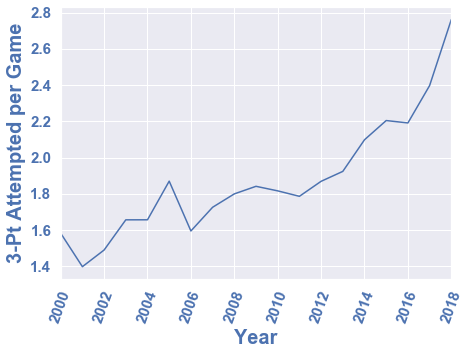

In [308]:
# Show how number of threes attempted has risen more than 50%
plt.figure(figsize=(7, 5))
league_avg_df.fg3a_per_g.plot()

plt.yticks(color='b', fontsize=15, weight='bold')
plt.xticks(rotation=70, color='b', fontsize=15, weight='bold')
plt.xlabel('Year', weight='bold', fontsize=20, color='b')
plt.ylabel('3-Pt Attempted per Game', weight='bold', fontsize=20, color='b');

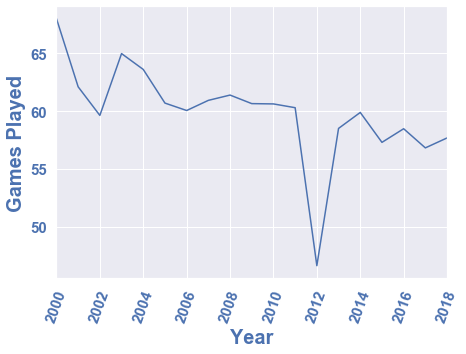

In [310]:
# Show how total stats can't be used - 2011-2012 was shortened season
# Players playing less games (rest)
plt.figure(figsize=(7, 5))
league_avg_df.g.plot()
plt.yticks(color='b', fontsize=15, weight='bold')
plt.xticks(rotation=70, color='b', fontsize=15, weight='bold')
plt.xlabel('Year', weight='bold', fontsize=20, color='b')
plt.ylabel('Games Played', weight='bold', fontsize=20, color='b');

In [56]:
league_avg_sum_df = league_avg_df.sum()

In [57]:
league_avg_sum_df

149.58941463665852

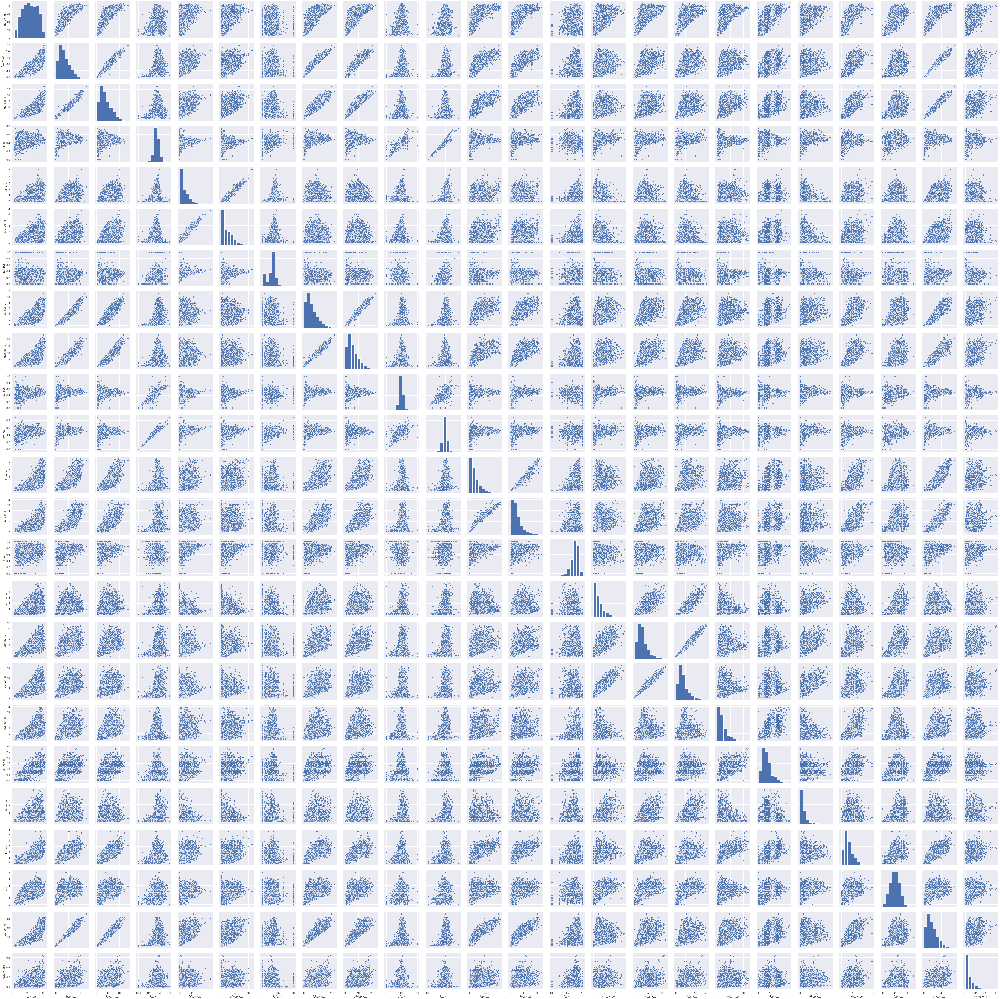

In [34]:
# Per game stats pairplot
sns.pairplot(per_game_df)

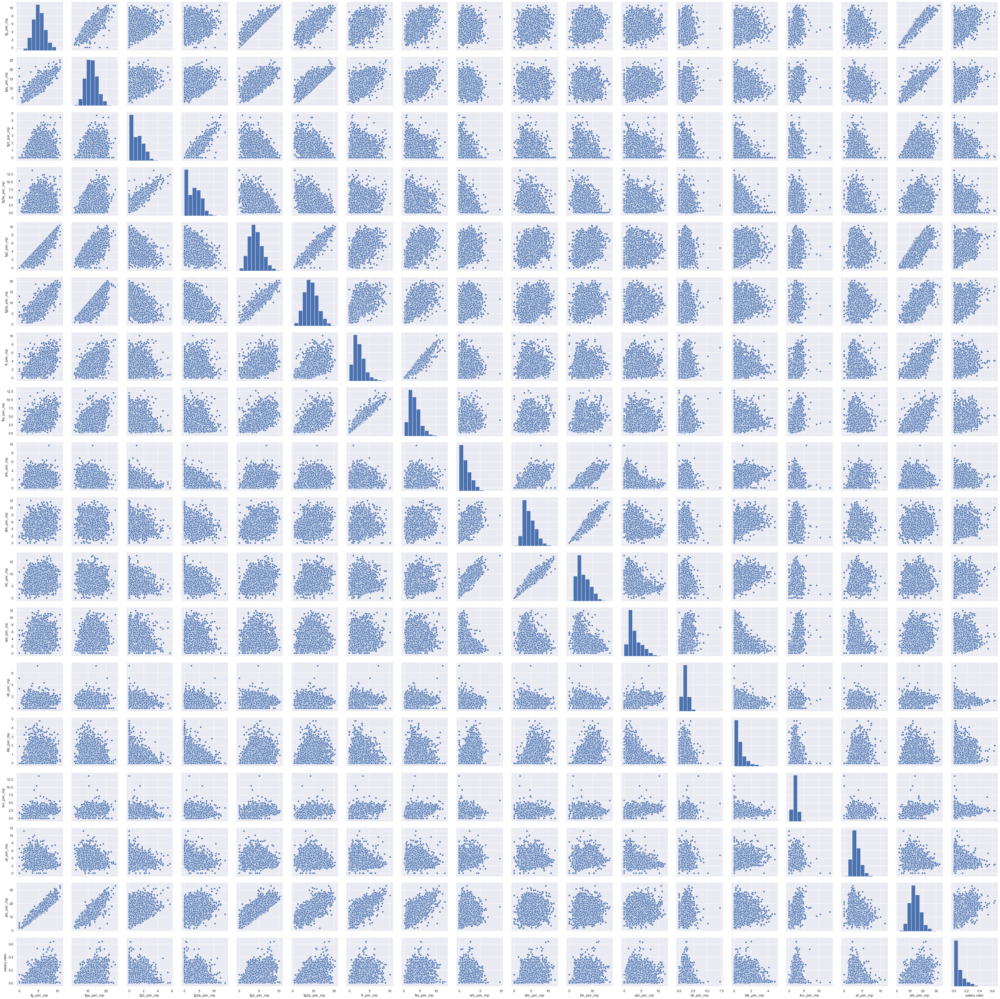

In [35]:
# Per 36 minutes stats pairplot
sns.pairplot(per_36_df)

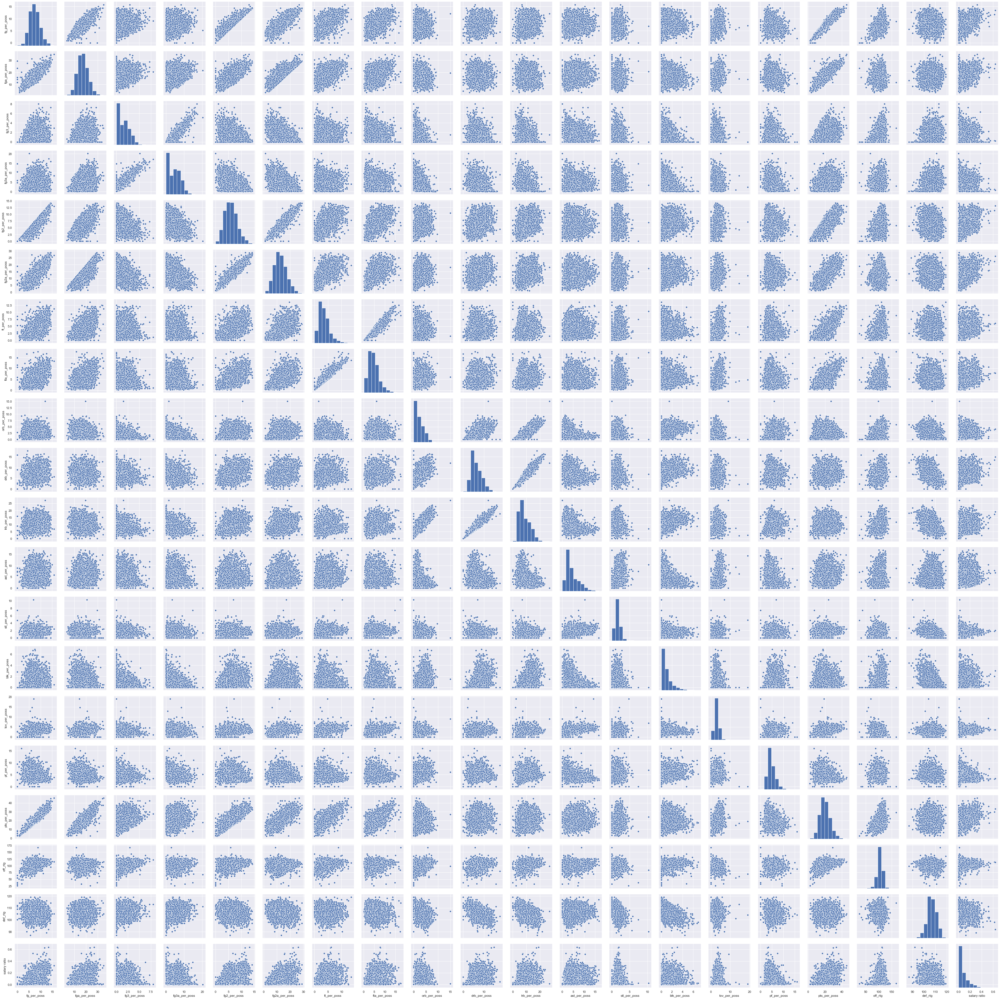

In [36]:
# Per 100 possessions stats pairplot
sns.pairplot(per_100_df)

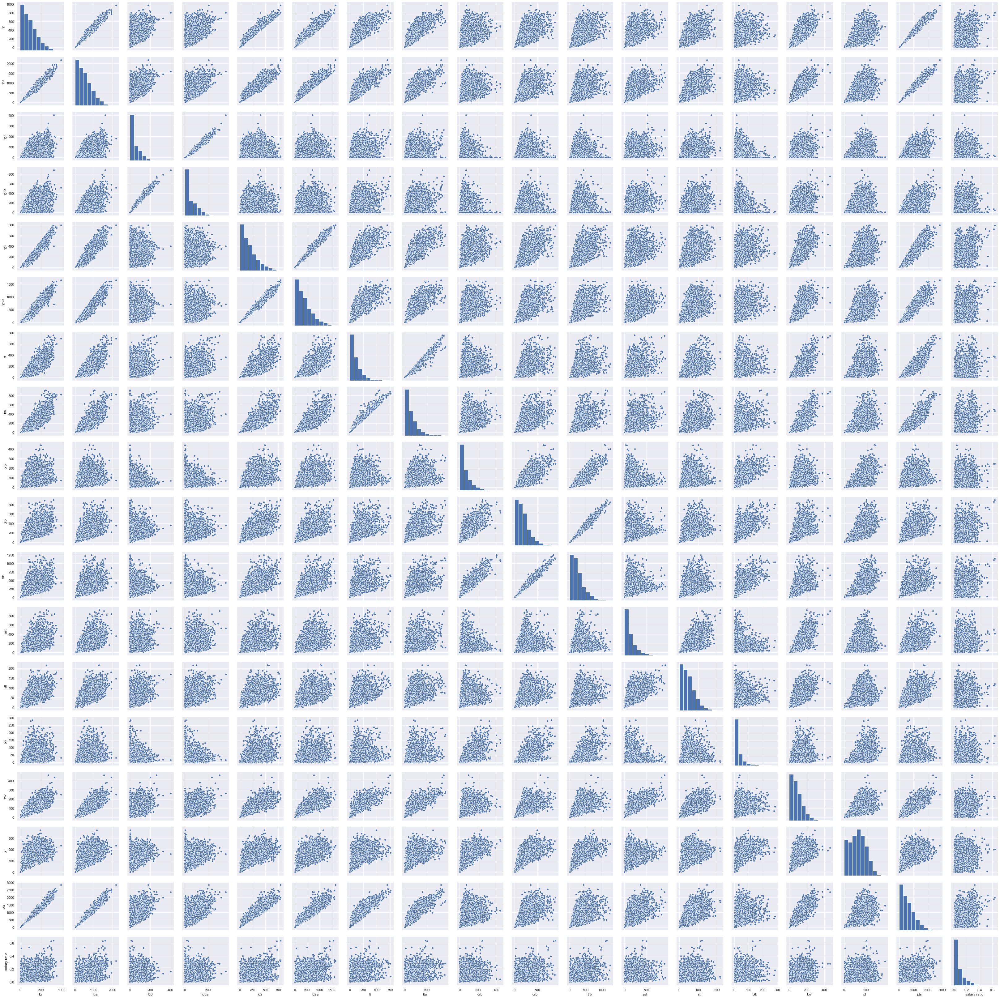

In [37]:
# Total stats pairplot
sns.pairplot(total_df)

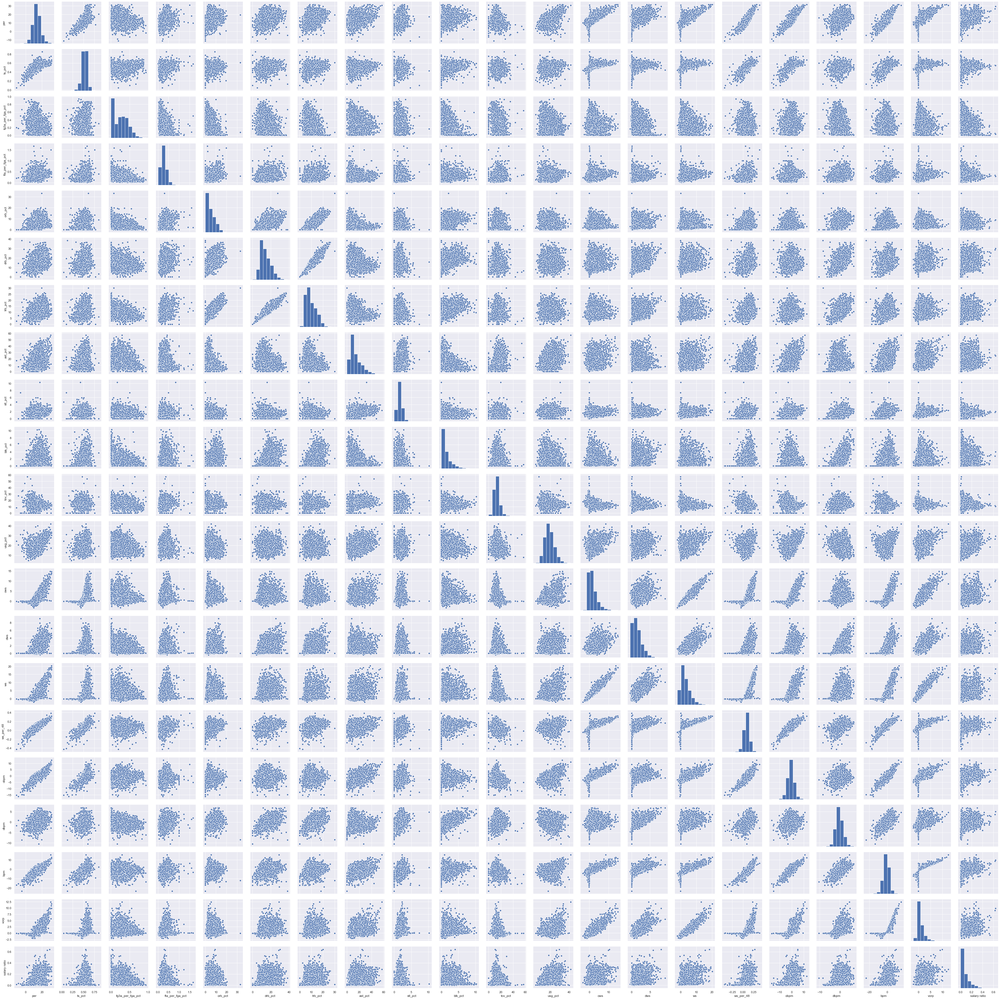

In [38]:
# Advanced stats pairplot
sns.pairplot(advanced_df)

### Per Game Stats Model

#### Set up train and val sets

In [20]:
X_train, X_val, y_train, y_val = (train_test_split
                                    (per_game_df.iloc[:, :-1], per_game_df.iloc[:, -1], 
                                     test_size=0.33,  # 33% validation, 67% training
                                     random_state=42))

#### Get R^2 on linear regression model

In [21]:
# Get R^2 on linear regression model
lm = LinearRegression()  # Linear regression candidate model
lm.fit(X_train, y_train)  # Fit on the training data

print(f'Linear Regression train R^2: {lm.score(X_train, y_train):.3f}')  # R^2 of model on training data
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')  # R^2 of model on validation data

Linear Regression train R^2: 0.487
Linear Regression val R^2: 0.503


#### Create polynomial model and get R^2 without scaling or regularization

In [22]:
poly = PolynomialFeatures(degree=2)
lm_poly = LinearRegression()  # Polynomial regression is linear regression with polynomial pre-processing

# Need to do feature transforms to train and val features so we can do our poly model on each
X_train_poly = poly.fit_transform(X_train.values)  # Does fitting and transforming in one step
X_val_poly = poly.transform(X_val.values)

lm_poly.fit(X_train_poly, y_train)  # Fit on the training data

print(f'Degree 2 polynomial regression train R^2: {lm_poly.score(X_train_poly, y_train):.3f}')
print(f'Degree 2 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')


Degree 2 polynomial regression train R^2: 0.688
Degree 2 polynomial regression val R^2: 0.396


#### Scale

In [23]:
# Scale the Predictors on both the train and test set
std = StandardScaler()
std.fit(X_train_poly)

X_tr = std.transform(X_train_poly)
X_val = std.transform(X_val_poly)

#### Lasso Regularization

In [24]:
# Lasso Regularization
alphalist = 10**(np.linspace(-5,7,200))  # Standard way to do a broad search across different order of magnitudes
err_vec_val = np.zeros(len(alphalist))  # Empty array for validation error
err_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):  # Enumerate over list of candidates. i is index, curr_alpha is value

    steps = [('standardize', StandardScaler()),   # Can standard scale and do a lasso model in one shot
             ('lasso', Lasso(alpha = curr_alpha))]  # alpha is the same thing as lambda in our presentations
                                                    # lambda = regularization strength
    # Pipeline packs multiple modeling steps into one fitting process
    pipe = Pipeline(steps)
    pipe.fit(X_train_poly, y_train)
    
    val_set_pred = pipe.predict(X_val_poly)  # Applies standard scale transformation, then model prediction step
    err_vec_val[i] = mae(y_val, val_set_pred)  # Mean average error of v_val and val_set_pred

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8443358486397415, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8017252367367185, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7284955619061044, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality ga

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0007844815944539896, tolerance: 0.0006085086085575101
  positive)


In [25]:
# This is the value of alpha that gave us the lowest error
alpha_min_error = alphalist[np.argmin(err_vec_val)]

# Fit a LASSO model on the standardized data
lasso_model = Lasso(alpha = alpha_min_error)
lasso_model.fit(X_tr, y_train)   # Fit final model on all of the data using the best value of alpha it found

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8443358486397415, tolerance: 0.0006085086085575101
  positive)


Lasso(alpha=1e-05, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

In [26]:
# Make predictions using the new model
val_set_pred = lasso_model.predict(X_val)  # Make predictions on validation set

#### Polynomial -> Scaled -> Lasso Regularization R^2

In [27]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it
r2_score(y_val, val_set_pred)


0.5224184691127534

### All Stats Model

#### Set up train and val sets

In [244]:
# Set up train and test sets

X_train, X_val, y_train, y_val = (train_test_split
                                    (pd.concat
                                     ([train_val_df.iloc[:, 6:67], train_val_df.iloc[:, 84:-1]], axis=1),  # Selecting all features
                                     train_val_df.iloc[:, -1],
                                     test_size=0.33,  # 33% validation, 67% training
                                     random_state=42))

#### Get R^2 on linear regression model

In [245]:
# Get R^2 on linear regression model
lm = LinearRegression()  # Linear regression candidate model
lm.fit(X_train, y_train)  # Fit on the training data

print(f'Linear Regression train R^2: {lm.score(X_train, y_train):.3f}')  # R^2 of model on training data
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')  # R^2 of model on validation data

Linear Regression train R^2: 0.593
Linear Regression val R^2: 0.599


#### Create polynomial model and get R^2 without scaling or regularization

In [247]:
# Create polynomial model and get R^2 without scaling or regularization
poly = PolynomialFeatures(degree=2)
lm_poly = LinearRegression()  # Polynomial regression is linear regression with polynomial pre-processing

# Need to do feature transforms to train and val features so we can do our poly model on each
X_train_poly = poly.fit_transform(X_train.values)  # Does fitting and transforming in one step
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(pd.concat  # Test data
                             ([test_2019_df.iloc[:, 6:67], test_2019_df.iloc[:, 84:-1]], axis=1).values)

lm_poly.fit(X_train_poly, y_train)  # Fit on the training data

print(f'Degree 2 polynomial regression train R^2: {lm_poly.score(X_train_poly, y_train):.3f}')
print(f'Degree 2 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')

Degree 2 polynomial regression train R^2: 1.000
Degree 2 polynomial regression val R^2: -8.503


#### Scale

In [248]:
# Scale the Predictors on both the train and test set
# This step fits the Standard Scaler to the training data
# Essentially it finds the mean and standard deviation of each variable in the training set
std = StandardScaler()  # Means and standard deviations of each feature column
std.fit(X_train_poly)  # Standardize scale of our polynomial training data

# This step applies the scaler to the train set.
# It subtracts the mean it learned in the previous step and then divides by the standard deviation
X_tr = std.transform(X_train_poly)  # Apply scaler to polynomial training data
X_val = std.transform(X_val_poly)  # Apply scaler to polynomial validation data
X_te = std.transform(X_test_poly)  # Apply scaler to polynomial test data

#### Lasso Regularization

In [249]:
# Lasso Regularization
alphalist = 10**(np.linspace(-5,0,100))  # Standard way to do a broad search across different order of magnitudes
err_vec_val = np.zeros(len(alphalist))  # Empty array for validation error
err_vec_test = np.zeros(len(alphalist))  # Empty array for test error
err_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):  # Enumerate over list of candidates. i is index, curr_alpha is value

    steps = [('standardize', StandardScaler()),   # Can standard scale and do a lasso model in one shot
             ('lasso', Lasso(alpha = curr_alpha))]  # alpha is the same thing as lambda in our presentations
                                                    # lambda = regularization strength
    # Pipeline packs multiple modeling steps into one fitting process
    pipe = Pipeline(steps)
    pipe.fit(X_train_poly, y_train)
    
    val_set_pred = pipe.predict(X_val_poly)  # Applies standard scale transformation, then model prediction step
    err_vec_val[i] = mae(y_val, val_set_pred)  # Mean average error of v_val and val_set_pred
    
    test_set_pred = pipe.predict(X_test_poly)  # Applies standard scale transformation, then model prediction step
    err_vec_test[i] = mae(test_2019_df.iloc[:,-1], test_set_pred)  # Mean average error of y_test and test_set_pred

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0606371147174096, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0098199606723406, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0031934239693725, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality ga

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.010977297132385821, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.00968325103862444, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.004847856458634503, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duali

In [250]:
# This is the value of alpha that gave us the lowest error
alpha_min_error = alphalist[np.argmin(err_vec_val)]

# This is the value of alpha that gave us the lowest error - test data
alpha_min_error_test = alphalist[np.argmin(err_vec_test)]

# Fit a LASSO model on the standardized data
lasso_model = Lasso(alpha = alpha_min_error)
lasso_model.fit(X_tr, y_train)   # Fit final model on all of the data using the best value of alpha it found

# Fit a LASSO model on the standardized data - test
lasso_model_test = Lasso(alpha = alpha_min_error_test)
lasso_model_test.fit(X_tr, y_train)   # Fit final model on all of the data using the best value of alpha it found

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.01130713561308383, tolerance: 0.0012569188440497052
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.03138411544675401, tolerance: 0.0012569188440497052
  positive)


Lasso(alpha=0.0002915053062825176, copy_X=True, fit_intercept=True,
      max_iter=1000, normalize=False, positive=False, precompute=False,
      random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [251]:
# Make predictions using the new model
val_set_pred = lasso_model.predict(X_val)  # Make predictions on validation set

# Make predictions using the new model - test
test_set_pred = lasso_model.predict(X_te)  # Make predictions on test set

#### Polynomial -> Scaled -> Lasso Regularization R^2

In [252]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it
r2_score(y_val, val_set_pred)

0.665312560516278

In [253]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it - test
r2_score(test_2019_df.iloc[:,-1], test_set_pred)

0.5704606535697792

In [272]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [422]:
output_df = pd.concat([test_2019_df.iloc[:, :67], test_2019_df.iloc[:, 84:-1]], axis=1)
output_df['predicted salary ratio'] = test_set_pred
output_df.insert(loc=2,
                 column='predicted salary', 
                 value=(output_df['predicted salary ratio']*output_df['salary cap']))
output_df.insert(loc=3,
                 column='% difference from actual salary', 
                 value=(
                     abs(output_df['predicted salary']-output_df['salary'])/output_df['predicted salary']
                 )
                )
output_df.drop('salary cap', axis=1)

,year,salary,predicted salary,% difference from actual salary,name,team_id,pos,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,predicted salary ratio
0,2019,5455236.00,1386954.20,2.93,ALEX ABRINES,OKC,SG,25,31,2,19.00,1.80,5.10,0.36,1.30,4.10,0.32,0.50,1.00,0.50,0.49,0.40,0.40,0.92,0.20,1.40,1.50,0.60,0.50,0.20,0.50,1.70,5.30,3.40,9.60,2.50,7.80,0.90,1.80,0.70,0.80,0.30,2.60,2.90,1.20,1.00,0.40,0.90,3.20,10.10,4.40,12.50,3.30,10.10,1.20,2.40,1.00,1.00,0.40,3.40,3.80,1.60,1.30,0.50,1.10,4.20,13.10,103.00,165,6.30,0.51,0.81,0.08,0.90,7.80,4.20,4.30,1.30,0.90,12.20,0.10,0.60,0.60,0.05,-2.40,-0.90,-3.40,-0.20,0.01
2,2019,270014.00,727446.01,0.63,JAYLEN ADAMS,ATL,PG,22,34,1,12.60,1.10,3.20,0.34,0.70,2.20,0.34,0.40,1.10,0.36,0.46,0.20,0.30,0.78,0.30,1.40,1.80,1.90,0.40,0.10,0.80,1.30,3.20,3.20,9.30,2.10,6.20,1.10,3.00,0.60,0.80,0.90,4.10,5.00,5.50,1.20,0.40,2.40,3.80,9.10,4.10,11.90,2.70,8.00,1.40,3.90,0.80,1.00,1.20,5.30,6.50,7.00,1.50,0.50,3.00,4.90,11.70,99.00,108,7.60,0.47,0.67,0.08,2.60,12.30,7.40,19.80,1.50,1.00,13.50,-0.10,0.20,0.10,0.01,-3.10,-1.30,-4.40,-0.30,0.01
3,2019,24157303.00,11938434.72,1.02,STEVEN ADAMS,OKC,C,25,80,80,33.40,6.00,10.10,0.59,0.00,0.00,0.00,6.00,10.10,0.60,0.59,1.80,3.70,0.50,4.90,4.60,9.50,1.60,1.50,1.00,1.70,2.60,13.90,6.50,10.90,0.00,0.00,6.50,10.90,2.00,3.90,5.30,5.00,10.30,1.70,1.60,1.00,1.80,2.80,14.90,8.40,14.10,0.00,0.00,8.40,14.10,2.60,5.10,6.80,6.50,13.30,2.20,2.00,1.30,2.40,3.60,19.40,120.00,1108,18.50,0.59,0.00,0.36,14.70,14.80,14.70,6.60,2.00,2.40,16.40,5.10,4.00,9.10,0.16,0.60,2.10,2.70,3.20,0.12
4,2019,2955840.00,4678065.05,0.37,BAM ADEBAYO,MIA,C,21,82,28,23.30,3.40,5.90,0.58,0.00,0.20,0.20,3.40,5.70,0.59,0.58,2.00,2.80,0.73,2.00,5.30,7.30,2.20,0.90,0.80,1.50,2.50,8.90,5.30,9.10,0.10,0.30,5.20,8.90,3.10,4.30,3.10,8.10,11.20,3.50,1.30,1.20,2.30,3.80,13.70,7.20,12.40,0.10,0.40,7.10,12.00,4.20,5.80,4.20,11.00,15.20,4.70,1.80,1.70,3.10,5.20,18.60,120.00,729,17.90,0.62,0.03,0.47,9.20,24.00,16.60,14.20,1.80,3.00,15.80,3.40,3.40,6.80,0.17,-0.60,3.60,3.00,2.40,0.05
7,2019,22347015.00,28666771.18,0.22,LAMARCUS ALDRIDGE,SAS,C,33,81,81,33.20,8.40,16.30,0.52,0.10,0.50,0.24,8.30,15.80,0.53,0.52,4.30,5.10,0.85,3.10,6.10,9.20,2.40,0.50,1.30,1.80,2.20,21.30,9.20,17.70,0.10,0.60,9.00,17.10,4.70,5.50,3.40,6.60,10.00,2.60,0.60,1.40,1.90,2.40,23.10,12.40,24.00,0.20,0.80,12.30,23.20,6.30,7.50,4.60,9.00,13.50,3.50,0.80,1.90,2.60,3.30,31.40,117.00,1727,22.90,0.58,0.03,0.31,10.30,19.80,15.10,11.60,0.80,3.40,26.90,6.40,2.90,9.30,0.17,1.20,0.50,1.60,2.50,0.28
9,2019,2074320.00,2017970.74,0.03,GRAYSON ALLEN,UTA,SG,23,38,2,10.90,1.80,4.70,0.38,0.80,2.60,0.32,0.90,2.10,0.44,0.47,1.20,1.60,0.75,0.10,0.50,0.60,0.70,0.20,0.20,0.90,1.20,5.60,5.80,15.40,2.80,8.60,3.00,6.80,3.90,5.20,0.30,1.70,2.00,2.20,0.50,0.50,2.90,4.10,18.30,7.70,20.50,3.70,11.40,4.00,9.10,5.20,6.90,0.30,2.30,2.60,2.90,0.70,0.70,3.80,5.40,24.30,95.00,211,7.50,0.52,0.56,0.34,0.80,5.10,3.00,8.90,0.70,1.10,24.40,-0.40,0.40,0.00,0.00,-3.70,-3.10,-6.80,-0.50,0.02
10,2019,2034120.00,7071660.55,0.71,JARRETT ALLEN,BRK,C,20,80,80,26.20,4.20,7.10,0.59,0.10,0.60,0.13,4.10,6.50,0.63,0.59,2.50,3.50,0.71,2.40,6.00,8.40,1.40,0.50,1.50,1.30,2.30,10.90,5.80,9.80,0.10,0.80,5.70,9.00,3.40,4.80,3.30,8.30,11.50,1.90,0.70,2.10,1.80,3.20,15.00,7.60,12.

In [423]:
output_df[output_df['predicted salary'] < 0] = 0

In [421]:
output_df[output_df['g'] > 50].sort_values(by=['% difference from actual salary'], ascending=False).head(15)

,year,salary,predicted salary,% difference from actual salary,salary cap,name,team_id,pos,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,predicted salary ratio
278,2019,487109.00,10524554.82,0.95,101869000,ENES KANTER,TOT,C,26,67,31,24.50,5.60,10.20,0.55,0.10,0.50,0.29,5.40,9.70,0.56,0.56,2.30,2.90,0.79,3.80,6.00,9.80,1.70,0.50,0.40,1.80,2.50,13.70,8.20,15.00,0.20,0.70,8.00,14.20,3.40,4.30,5.60,8.80,14.50,2.50,0.70,0.60,2.60,3.70,20.10,11.00,20.10,0.30,1.00,10.70,19.10,4.60,5.80,7.60,11.80,19.40,3.40,0.90,0.80,3.50,4.90,26.90,118.00,915,22.30,0.59,0.05,0.29,16.40,26.10,21.10,12.10,0.90,1.30,23.10,3.90,1.60,5.40,0.16,1.50,-0.20,1.30,1.40,0.10
329,2019,512746.00,11067147.43,0.95,101869000,WESLEY MATTHEWS,TOT,SF,32,69,68,30.30,4.00,10.10,0.40,2.20,5.80,0.37,1.90,4.30,0.44,0.51,1.90,2.40,0.81,0.50,2.00,2.50,2.30,0.80,0.20,1.30,2.30,12.20,4.80,12.00,2.60,6.90,2.20,5.10,2.30,2.80,0.60,2.40,2.90,2.80,0.90,0.30,1.60,2.80,14.50,6.50,16.20,3.50,9.40,3.00,6.90,3.10,3.80,0.70,3.20,4.00,3.70,1.30,0.40,2.10,3.70,19.50,107.00,840,10.30,0.55,0.58,0.23,1.70,7.10,4.40,11.10,1.30,0.70,17.80,1.10,1.50,2.70,0.06,-0.30,-1.20,-1.50,0.30,0.11
172,2019,196553.00,3257043.73,0.94,101869000,TIM FRAZIER,TOT,PG,28,59,19,19.00,2.00,4.40,0.44,0.60,1.70,0.37,1.30,2.70,0.49,0.52,0.70,0.90,0.76,0.70,2.20,2.80,4.20,0.50,0.10,1.30,1.90,5.30,3.70,8.40,1.20,3.20,2.50,5.10,1.30,1.70,1.30,4.10,5.40,8.00,1.00,0.20,2.40,3.60,10.00,4.80,10.80,1.50,4.20,3.30,6.60,1.70,2.20,1.70,5.30,7.00,10.30,1.20,0.20,3.20,4.60,12.90,114.00,310,11.70,0.54,0.39,0.21,3.90,11.50,7.70,27.60,1.20,0.40,13.30,1.30,0.70,2.00,0.08,-1.00,-1.30,-2.30,-0.10,0.03
305,2019,487109.00,6545834.07,0.93,101869000,JEREMY LIN,TOT,PG,30,74,4,19.40,3.20,7.30,0.44,0.70,2.50,0.29,2.50,4.80,0.52,0.49,2.40,2.80,0.84,0.30,2.10,2.40,3.10,0.60,0.20,1.70,1.90,9.60,6.00,13.60,1.40,4.70,4.60,8.90,4.40,5.30,0.60,3.90,4.50,5.80,1.20,0.30,3.10,3.60,17.70,7.70,17.60,1.80,6.10,6.00,11.50,5.70,6.80,0.70,5.10,5.80,7.50,1.50,0.40,4.00,4.70,23.00,108.00,707,13.50,0.56,0.35,0.39,1.60,11.70,6.60,23.40,1.50,0.80,21.80,1.20,0.90,2.10,0.07,-1.10,-1.80,-2.90,-0.30,0.06
361,2019,427288.00,5603475.44,0.92,101869000,MARKIEFF MORRIS,TOT,PF,29,58,16,21.90,3.50,8.30,0.42,1.20,3.50,0.34,2.30,4.80,0.48,0.49,1.20,1.60,0.77,1.10,3.50,4.60,1.40,0.60,0.40,0.90,3.00,9.40,5.80,13.70,1.90,5.80,3.90,8.00,2.00,2.60,1.70,5.80,7.50,2.20,1.00,0.60,1.50,5.00,15.50,7.60,18.00,2.50,7.50,5.00,10.40,2.60,3.40,2.30,7.60,9.80,2.90,1.30,0.80,2.00,6.50,20.30,106.00,547,11.70,0.52,0.42,0.19,5.00,17.50,11.10,8.80,1.30,1.50,19.10,0.60,1.10,1.60,0.06,-1.70,-1.10,-2.80,-0.30,0.06
492,2019,1512601.00,19626522.07,0.92,101869000,DWYANE WADE,MIA,SG,37,72,2,26.20,5.80,13.30,0.43,1.20,3.60,0.33,4.60,9.70,0.47,0.48,2.30,3.20,0.71,1.00,3.00,4.00,4.20,0.80,0.50,2.30,1.60,15.00,7.90,18.30,1.60,5.00,6.30,13.30,3.20,4.40,1.30,4.10,5.40,5.70,1.10,0.70,3.20,2.30,20.70,10.80,24.90,2.20,6.80,8.60,18.10,4.30,6.00,1.80,5.60,7.40,7.80,1.50,1.00,4.30,3.10,28.10,102.00,1083,15.80,0.51,0.27,0.24,3.90,12.20,8.00,26.50,1.50,1.80,27.90,0.10,2.30,2.40,0.06,-0.40,0.00,-0.50,0.70,0.19
336,2019,1512601.00,14990894.12,0.90,101869000,JAVALE MCGEE,LAL,C,31,75,62,22.30,5.30,8.50,0.62,0.00,0.20,0.08,5.30,8.40,0.63,0.62,1.30,2.00,0.63,2.60,4.90,7.50,0.70,0.60,2.00,1.40,2.80,12.0

In [424]:
output_df[output_df['g'] > 50 & (output_df['predicted salary'] > output_df['salary'])].sort_values(by=['% difference from actual salary'], ascending=False).head(15)

,year,salary,predicted salary,% difference from actual salary,salary cap,name,team_id,pos,age,g,gs,mp_per_g,fg_per_g,fga_per_g,fg_pct,fg3_per_g,fg3a_per_g,fg3_pct,fg2_per_g,fg2a_per_g,fg2_pct,efg_pct,ft_per_g,fta_per_g,ft_pct,orb_per_g,drb_per_g,trb_per_g,ast_per_g,stl_per_g,blk_per_g,tov_per_g,pf_per_g,pts_per_g,fg_per_mp,fga_per_mp,fg3_per_mp,fg3a_per_mp,fg2_per_mp,fg2a_per_mp,ft_per_mp,fta_per_mp,orb_per_mp,drb_per_mp,trb_per_mp,ast_per_mp,stl_per_mp,blk_per_mp,tov_per_mp,pf_per_mp,pts_per_mp,fg_per_poss,fga_per_poss,fg3_per_poss,fg3a_per_poss,fg2_per_poss,fg2a_per_poss,ft_per_poss,fta_per_poss,orb_per_poss,drb_per_poss,trb_per_poss,ast_per_poss,stl_per_poss,blk_per_poss,tov_per_poss,pf_per_poss,pts_per_poss,off_rtg,pts,per,ts_pct,fg3a_per_fga_pct,fta_per_fga_pct,orb_pct,drb_pct,trb_pct,ast_pct,stl_pct,blk_pct,usg_pct,ows,dws,ws,ws_per_48,obpm,dbpm,bpm,vorp,predicted salary ratio
175,2019,8339880.00,827861.78,9.07,101869000,MARKELLE FULTZ,PHI,SG,20,19,15,22.50,3.40,8.20,0.42,0.20,0.70,0.29,3.20,7.40,0.43,0.43,1.10,1.90,0.57,1.40,2.30,3.70,3.10,0.90,0.30,1.30,2.70,8.20,5.50,13.10,0.30,1.20,5.10,11.90,1.80,3.10,2.20,3.70,5.90,5.00,1.40,0.40,2.10,4.40,13.10,7.20,17.10,0.40,1.50,6.70,15.60,2.30,4.10,2.90,4.90,7.70,6.50,1.90,0.60,2.80,5.80,17.10,99.00,155,10.50,0.45,0.09,0.24,6.60,10.60,8.70,19.50,1.90,0.90,19.30,-0.10,0.40,0.30,0.04,-2.90,-0.10,-3.10,-0.10,0.01
378,2019,4155720.00,424721.29,8.78,101869000,FRANK NTILIKINA,NYK,PG,20,43,16,21.00,2.20,6.60,0.34,0.80,2.70,0.29,1.40,3.90,0.37,0.40,0.50,0.70,0.77,0.30,1.70,2.00,2.80,0.70,0.30,1.30,2.40,5.70,3.80,11.20,1.30,4.60,2.50,6.70,0.90,1.20,0.50,3.00,3.50,4.80,1.20,0.60,2.20,4.10,9.80,5.10,15.00,1.80,6.10,3.30,8.90,1.20,1.60,0.60,4.00,4.60,6.50,1.60,0.70,3.00,5.50,13.10,88.00,246,6.00,0.42,0.41,0.11,1.40,8.90,5.00,19.50,1.60,1.30,16.60,-1.30,0.40,-0.80,-0.04,-4.50,-1.20,-5.70,-0.80,0.00
15,2019,20421546.00,2377404.21,7.59,101869000,RYAN ANDERSON,TOT,PF,30,25,8,12.90,0.80,2.80,0.30,0.40,1.60,0.23,0.50,1.20,0.41,0.37,0.50,0.60,0.75,0.70,1.40,2.20,0.80,0.20,0.00,0.60,1.00,2.50,2.30,7.70,1.00,4.50,1.30,3.20,1.30,1.80,2.00,4.00,6.00,2.10,0.40,0.10,1.60,2.80,7.00,3.10,10.30,1.30,6.00,1.80,4.30,1.80,2.40,2.70,5.40,8.00,2.80,0.60,0.10,2.10,3.70,9.40,90.00,63,4.60,0.41,0.58,0.23,6.10,12.50,9.20,7.80,0.60,0.30,12.00,-0.30,0.00,-0.20,-0.04,-4.50,-2.00,-6.40,-0.40,0.02
30,2019,4865040.00,635131.28,6.66,101869000,MO BAMBA,ORL,C,20,47,1,16.30,2.50,5.20,0.48,0.40,1.50,0.30,2.00,3.70,0.56,0.53,0.80,1.30,0.59,1.40,3.60,5.00,0.80,0.30,1.40,0.90,2.20,6.20,5.50,11.40,1.00,3.30,4.50,8.10,1.70,3.00,3.00,7.90,11.00,1.80,0.60,3.00,2.00,4.80,13.70,7.50,15.50,1.30,4.50,6.10,11.10,2.40,4.00,4.10,10.80,14.90,2.50,0.80,4.10,2.70,6.50,18.70,105.00,292,14.90,0.54,0.29,0.26,8.80,24.00,16.30,7.40,0.80,7.00,17.80,0.30,1.40,1.70,0.11,-3.30,3.10,-0.20,0.40,0.01
184,2019,2207040.00,291807.72,6.56,101869000,HARRY GILES,SAC,PF,20,58,0,14.10,3.00,6.00,0.50,0.00,0.10,0.00,3.00,5.90,0.51,0.50,1.00,1.60,0.64,1.10,2.70,3.80,1.50,0.50,0.40,1.30,2.60,7.00,7.70,15.30,0.00,0.30,7.70,15.00,2.50,4.00,2.90,6.80,9.70,3.70,1.40,1.00,3.20,6.60,17.90,9.90,19.80,0.00,0.30,9.90,19.40,3.30,5.20,3.70,8.90,12.60,4.80,1.80,1.20,4.10,8.50,23.20,102.00,408,14.40,0.53,0.02,0.26,8.10,20.10,14.00,15.20,1.80,2.30,23.20,0.00,1.00,1.00,0.06,-3.00,0.90,-2.10,0.00,0.00
383,2019,4449000.00,638924.24,5.96,101869000,KYLE O'QUINN,IND,C,28,45,3,8.20,1.50,3.00,0.51,0.00,0.30,0.08,1.50,2.80,0.55,0.51,0.40,0.50,0.81,0.60,2.00,2.60,1.20,0.20,0.60,0.70,1.50,3.50,6.70,13.20,0.10,1.20,6.60,12.00,1.60,2.00,2.80,8.70,11.50,5.40,0.90,2.40,3.00,6.60,15.10,9.10,17.90,0.10,1.60,9.00,16.30,2.20,2.80,3.80,11.90,15.70,7.40,1.20,3.30,4.10,9.00,20.60,106.00,156,16.80,0.54,0.09,0.15,8.90,26.40,17.80,22.40,1.20,6.00,20.80,0.20,0.80,1.00,0.12,-2.40,4.10,1.80,0.40,0.01
160,2019,9600000.00,1475588.30,5.51,101869000,DANTE EXUM,UTA,PG,23,42,1,15.80,2.40,5.70,0.42,0.40,1.50,0.29,2.00,4.30,0.46,0.46,1.60,2.00,0.79,0.40,1.20,1.60,2.60,0.30,0.10,1.20,1.60,6.90,5.50,13.10,1.00,3.40

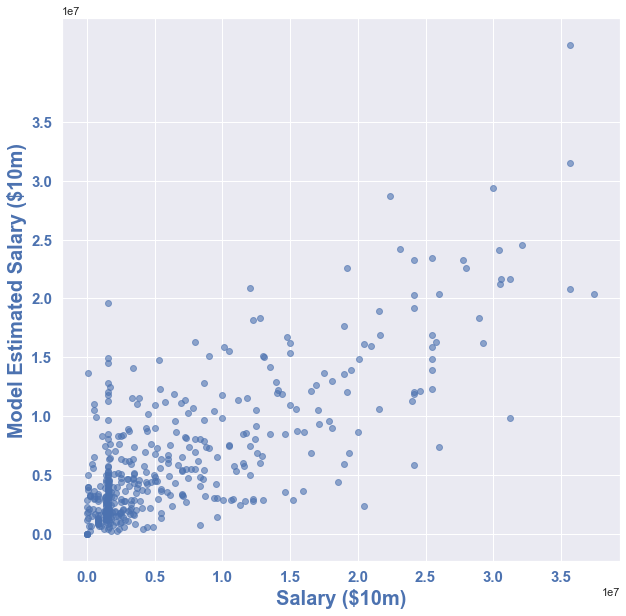

In [396]:
plt.figure(figsize=(10, 10))

plt.yticks(np.arange(0, 40000000, 5000000), color='b', fontsize=15, weight='bold')
plt.xticks(color='b', fontsize=15, weight='bold')
plt.xlabel('Salary ($10m)', weight='bold', fontsize=20, color='b')
plt.ylabel('Model Estimated Salary ($10m)', weight='bold', fontsize=20, color='b');

plt.scatter(output_df.iloc[:, 1], output_df.iloc[:, 2], alpha='0.6')


#### Use Model to Score and Predict

ValueError: `bins` must increase monotonically, when an array

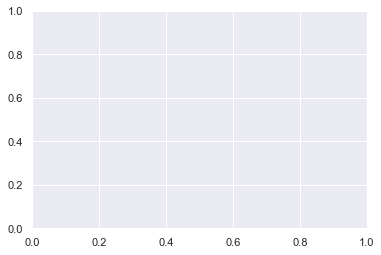

In [338]:
plt.hist(np.log10(alphalist), err_vec_test)


In [259]:
np.min(err_vec_test)


0.03605343908432667

In [315]:
MAE_final = mae(output_df.iloc[:, 1], output_df.iloc[:, 2])


In [316]:
MAE_final / 101869000


0.035824297828909044

### Advanced Stats Model

#### Set up train and val sets

In [40]:
# Set up train and test sets
X_train, X_val, y_train, y_val = (train_test_split
                                    (advanced_df.iloc[:, :-1], advanced_df.iloc[:, -1],  # Selecting advanced stat
                                     test_size=0.33,  # 33% validation, 67% training
                                     random_state=42))

#### Get R^2 on linear regression model

In [41]:
# Get R^2 on linear regression model
lm = LinearRegression()  # Linear regression candidate model
lm.fit(X_train, y_train)  # Fit on the training data

print(f'Linear Regression train R^2: {lm.score(X_train, y_train):.3f}')  # R^2 of model on training data
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')  # R^2 of model on validation data

Linear Regression train R^2: 0.438
Linear Regression val R^2: 0.457


#### Create polynomial model and get R^2 without scaling or regularization

In [42]:
# Create polynomial model and get R^2 without scaling or regularization
poly = PolynomialFeatures(degree=2)
lm_poly = LinearRegression()  # Polynomial regression is linear regression with polynomial pre-processing

# Need to do feature transforms to train and val features so we can do our poly model on each
X_train_poly = poly.fit_transform(X_train.values)  # Does fitting and transforming in one step
X_val_poly = poly.transform(X_val.values)

lm_poly.fit(X_train_poly, y_train)  # Fit on the training data

print(f'Degree 2 polynomial regression train R^2: {lm_poly.score(X_train_poly, y_train):.3f}')
print(f'Degree 2 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')

Degree 2 polynomial regression train R^2: 0.600
Degree 2 polynomial regression val R^2: 0.266


#### Scale

In [43]:
# Scale the Predictors on both the train and test set
# This step fits the Standard Scaler to the training data
# Essentially it finds the mean and standard deviation of each variable in the training set
std = StandardScaler()  # Means and standard deviations of each feature column
std.fit(X_train_poly)  # Standardize scale of our polynomial training data

# This step applies the scaler to the train set.
# It subtracts the mean it learned in the previous step and then divides by the standard deviation
X_tr = std.transform(X_train_poly)  # Apply scaler to polynomial training data
X_val = std.transform(X_val_poly)  # Apply scaler to polynomial validation data

#### Lasso Regularization

In [44]:
# Lasso Regularization
alphalist = 10**(np.linspace(-5,2,50))  # Standard way to do a broad search across different order of magnitudes
err_vec_val = np.zeros(len(alphalist))  # Empty array for validation error
err_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):  # Enumerate over list of candidates. i is index, curr_alpha is value

    steps = [('standardize', StandardScaler()),   # Can standard scale and do a lasso model in one shot
             ('lasso', Lasso(alpha = curr_alpha))]  # alpha is the same thing as lambda in our presentations
                                                    # lambda = regularization strength
    # Pipeline packs multiple modeling steps into one fitting process
    pipe = Pipeline(steps)
    pipe.fit(X_train_poly, y_train)
    
    val_set_pred = pipe.predict(X_val_poly)  # Applies standard scale transformation, then model prediction step
    err_vec_val[i] = mae(y_val, val_set_pred)  # Mean average error of v_val and val_set_pred

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.059659988747801, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9528243011652765, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8484944224481943, tolerance: 0.0006085086085575101
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap

In [45]:
# This is the value of alpha that gave us the lowest error
alpha_min_error = alphalist[np.argmin(err_vec_val)]

# Fit a LASSO model on the standardized data
lasso_model = Lasso(alpha = alpha_min_error)
lasso_model.fit(X_tr, y_train)   # Fit final model on all of the data using the best value of alpha it found

Lasso(alpha=0.0005179474679231213, copy_X=True, fit_intercept=True,
      max_iter=1000, normalize=False, positive=False, precompute=False,
      random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [46]:
# Make predictions using the new model
val_set_pred = lasso_model.predict(X_val)  # Make predictions on validation set

#### Polynomial -> Scaled -> Lasso Regularization R^2

In [47]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it
r2_score(y_val, val_set_pred)

0.4736530940399357

### Advanced Stats Model

#### Set up train and val sets

In [71]:
# Set up train and test sets
X_train, X_val, y_train, y_val = (train_test_split
                                    (advanced_df.iloc[:, :-1], advanced_df.iloc[:, -1],  # Selecting advanced stat
                                     test_size=0.33,  # 33% validation, 67% training
                                     random_state=42))

#### Get R^2 on linear regression model

In [72]:
# Get R^2 on linear regression model
lm = LinearRegression()  # Linear regression candidate model
lm.fit(X_train, y_train)  # Fit on the training data

print(f'Linear Regression train R^2: {lm.score(X_train, y_train):.3f}')  # R^2 of model on training data
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')  # R^2 of model on validation data

Linear Regression train R^2: 0.413
Linear Regression val R^2: 0.365


#### Create polynomial model and get R^2 without scaling or regularization

In [73]:
# Create polynomial model and get R^2 without scaling or regularization
poly = PolynomialFeatures(degree=2)
lm_poly = LinearRegression()  # Polynomial regression is linear regression with polynomial pre-processing

# Need to do feature transforms to train and val features so we can do our poly model on each
X_train_poly = poly.fit_transform(X_train.values)  # Does fitting and transforming in one step
X_val_poly = poly.transform(X_val.values)

lm_poly.fit(X_train_poly, y_train)  # Fit on the training data

print(f'Degree 2 polynomial regression train R^2: {lm_poly.score(X_train_poly, y_train):.3f}')
print(f'Degree 2 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')

Degree 2 polynomial regression train R^2: 0.488
Degree 2 polynomial regression val R^2: 0.370


#### Scale

In [74]:
# Scale the Predictors on both the train and test set
# This step fits the Standard Scaler to the training data
# Essentially it finds the mean and standard deviation of each variable in the training set
std = StandardScaler()  # Means and standard deviations of each feature column
std.fit(X_train_poly)  # Standardize scale of our polynomial training data

# This step applies the scaler to the train set.
# It subtracts the mean it learned in the previous step and then divides by the standard deviation
X_tr = std.transform(X_train_poly)  # Apply scaler to polynomial training data
X_val = std.transform(X_val_poly)  # Apply scaler to polynomial validation data

#### Lasso Regularization

In [75]:
# Lasso Regularization
alphalist = 10**(np.linspace(-5,2,50))  # Standard way to do a broad search across different order of magnitudes
err_vec_val = np.zeros(len(alphalist))  # Empty array for validation error
err_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):  # Enumerate over list of candidates. i is index, curr_alpha is value

    steps = [('standardize', StandardScaler()),   # Can standard scale and do a lasso model in one shot
             ('lasso', Lasso(alpha = curr_alpha))]  # alpha is the same thing as lambda in our presentations
                                                    # lambda = regularization strength
    # Pipeline packs multiple modeling steps into one fitting process
    pipe = Pipeline(steps)
    pipe.fit(X_train_poly, y_train)
    
    val_set_pred = pipe.predict(X_val_poly)  # Applies standard scale transformation, then model prediction step
    err_vec_val[i] = mae(y_val, val_set_pred)  # Mean average error of v_val and val_set_pred

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.983264718384562, tolerance: 0.002662833776909082
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.313225961258157, tolerance: 0.002662833776909082
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.400792869276642, tolerance: 0.002662833776909082
  positive)
//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6

In [76]:
# This is the value of alpha that gave us the lowest error
alpha_min_error = alphalist[np.argmin(err_vec_val)]

# Fit a LASSO model on the standardized data
lasso_model = Lasso(alpha = alpha_min_error)
lasso_model.fit(X_tr, y_train)   # Fit final model on all of the data using the best value of alpha it found

//anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.02341612798610626, tolerance: 0.002662833776909082
  positive)


Lasso(alpha=0.0001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

In [77]:
# Make predictions using the new model
val_set_pred = lasso_model.predict(X_val)  # Make predictions on validation set

#### Polynomial -> Scaled -> Lasso Regularization R^2

In [78]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it
r2_score(y_val, val_set_pred)


0.3874004642789921

In [ ]:
# This is the best alpha value it found
lasso_model.alpha_

In [ ]:
# Note that now we can meaningfully compare the importance of different features,
# since they're on the same scale

# But it's now difficult to interpret the coefficients
# We would need to translate back to the original feature scales by dividing
# each coefficient by the original column's standard deviation

list(zip(X_train.columns, lasso_model.coef_))

In [ ]:
# Make predictions using the new model
val_set_pred = lasso_model.predict(X_val)  # Make predictions on validation set

In [ ]:
# Degree 2 polynomial, scaled, then Lasso regularization done to it
r2_score(y_val, val_set_pred)